<a href="https://colab.research.google.com/github/RafaelaAfferri/fontes_web/blob/main/aula02_aula.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Análise de texto de fontes desestruturadas e Web

## Aula 02

Nesta aula iremos trabalhar com extração de informações a partir de imagens (seja JPG ou transformando PDFs) utilizando bibliotecas Python para reconhecimento ótico de caracteres (OCR). A principal biblioteca que utilizaremos será a **EasyOCR** https://github.com/JaidedAI/EasyOCR.


## Instalando o EasyOCR

Primeiro, vamos instalar a biblioteca que fará a conversão das imagens em texto:

In [8]:
!pip install easyocr

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 43.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 180.7/180.7 kB 16.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 978.2/978.2 kB 55.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 300.6/300.6 kB 23.1 MB/s eta 0:00:00


## Instalando o pdf2image

Agora, vamos instalar a biblioteca para conversão de PDF em imagem:

In [9]:
!pip install pdf2image

In [4]:
!sudo apt-get update
!sudo apt-get install libpoppler-dev
!sudo apt -y install poppler-utils

Get:1 https://cli.github.com/packages stable InRelease [3,917 B]
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:3 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:4 https://cli.github.com/packages stable/main amd64 Packages [357 B]
Get:5 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:8 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [9,773 kB]
Get:9 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease [18.1 kB]
Get:10 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,613 kB]
Get:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease [24.6 kB]
Get:12 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,301 kB]
Get:13 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]


## Instalando o ipycanvas

Agora, vamos instalar a biblioteca para desenho livre (ver final do notebook):

In [6]:
!pip install ipywidgets==7.6.5
!pip install ipycanvas==0.11.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 255.8/255.8 kB 5.4 MB/s eta 0:00:00


## Instalando o opencv

Agora, vamos instalar a biblioteca para exibição e desenho nas imagens:

In [2]:
!pip install opencv-python
!pip install --upgrade opencv-contrib-python
!pip install opencv-python-headless

## Importando as bibliotecas necessárias

Agora, vamos importar as bibliotecas necessárias:

In [ ]:
#import os
#os.environ["KMP_DUPLICATE_LIB_OK"]="True"

In [10]:
# Canvas hand drawing
from ipywidgets import Image
from ipywidgets import ColorPicker, IntSlider, link, AppLayout, HBox
from ipycanvas import Canvas, hold_canvas

# OCR
import easyocr

# PDF para imagem
from pdf2image import convert_from_path

# para trabalhar com diretórios / sistema operacional
import os

# para os DataFrames
import pandas as pd

# para exibir os arquivos de imagem
import cv2
import matplotlib.pyplot as plt

Caso obtenha algum erro, utilize o **!pip install** para instalar a biblioteca ausente!

Vamos conferir em qual diretório estamos executando o notebook?

In [11]:
print("O seu notebook está no diretório")
print(os.getcwd())

O seu notebook está no diretório
/content


## Baixando os dados

Se estiver no Colab, utilize este comando para ter acesso às imagens utilizadas durante a aula:

In [12]:
!wget "https://atd-insper.s3.us-east-2.amazonaws.com/aula03/dados3.zip"
!unzip -P xspabc1 dados3.zip
!ls

--2026-02-24 22:56:34--  https://atd-insper.s3.us-east-2.amazonaws.com/aula03/dados3.zip
Resolving atd-insper.s3.us-east-2.amazonaws.com (atd-insper.s3.us-east-2.amazonaws.com)... 3.5.130.14, 3.5.92.81, 3.5.92.6, ...
Connecting to atd-insper.s3.us-east-2.amazonaws.com (atd-insper.s3.us-east-2.amazonaws.com)|3.5.130.14|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 17624296 (17M) [application/zip]
Saving to: ‘dados3.zip’

dados3.zip          100%[===================>]  16.81M  18.3MB/s    in 0.9s    

2026-02-24 22:56:35 (18.3 MB/s) - ‘dados3.zip’ saved [17624296/17624296]

Archive:  dados3.zip
  inflating: handwriting.png         
  inflating: id_alabama-drivers-license.jpg  
  inflating: id_uk-driving-licence.jpg  
  inflating: livros_aiwplain1.jpg    
  inflating: livros_ipad.jpg         
  inflating: livros_nlp_2.jpg        
  inflating: livros_nlp.jpg          
  inflating: livros_nlp_ods_course.jpg  
  inflating: RP_4600023295_NF_1266.pdf  
  inflating: 

## Um primeiro exemplo!

Iremos realizar a leitura dos dados de um documento que está armazenado como uma imagem.

Primeiro, vamos indicar o caminho da imagem em uma variável.

In [13]:
imagem_caminho = "id_uk-driving-licence.jpg"

Iremos exibir a imagem na tela:

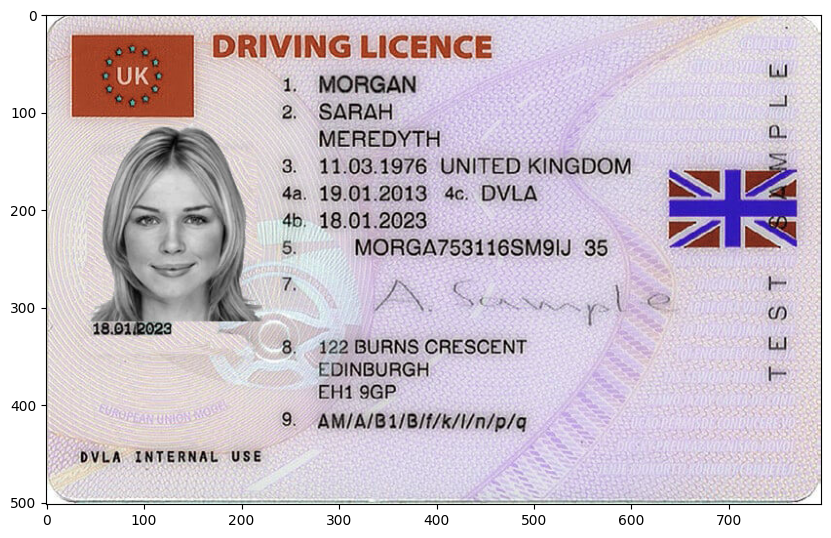

In [14]:
img = cv2.imread(imagem_caminho)

plt.rcParams["figure.figsize"] = (10,10)

plt.imshow(img);

Então, utilizaremos um **Reader** do **EasyOCR** para realizar a transcrição dos dados contidos na imagem.

In [15]:
reader = easyocr.Reader(['en', 'pt'], gpu=False)

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Para ver mais detalhes sobre a documentação do EasyOCR, acesse https://www.jaided.ai/easyocr/documentation/

E por fim podemos fazer o reconhecimento dos caracteres com:

In [22]:
texto = reader.readtext(imagem_caminho, detail=0)

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:775: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  super().__init__(loader)


### Identificação das regiões onde houve reconhecimento de texto

Podemos utilizar uma funcionalidade do EasyOCR que permite identificar em quais regiões da imagem houve reconhecimento de caracteres (*bounding boxes*).

Para isso, iremos realizar a leitura novamente, mas sem o parâmetro **detail=0**. Neste caso, você pode remover o parâmetro detail ou deixá-lo com valor 1.

Agora, vamos utilizar o OpenCV para conseguir exibir a imagem, identificando com retângulos as posições onde houve leitura de texto:

In [24]:
texto = reader.readtext(imagem_caminho)

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:775: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  super().__init__(loader)


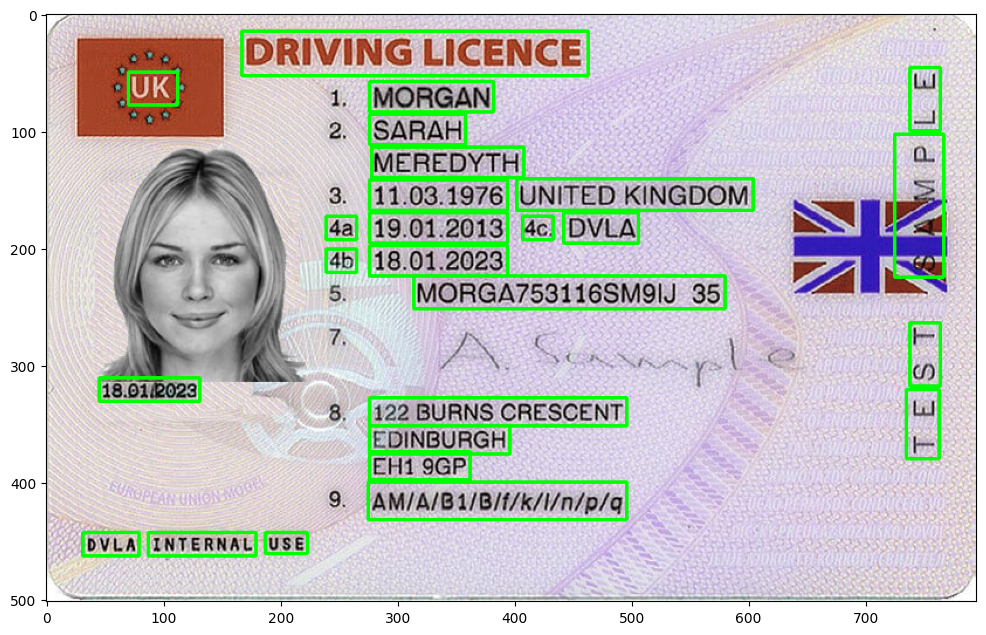

In [25]:
img = cv2.imread(imagem_caminho)

for (rec, txt, prob) in texto:
    # Coordenadas do retângulo a ser desenhado
    (sup_esq, sup_dir, inf_dir, inf_esq) = rec
    sup_esq   = (int(sup_esq[0]), int(sup_esq[1]))
    inf_dir   = (int(inf_dir[0]), int(inf_dir[1]))

    # Identifica, com um retângulo, as regiões da imagem em que houve leitura de texto
    cv2.rectangle(img, sup_esq, inf_dir, (0, 255, 0), 2)

plt.rcParams["figure.figsize"] = (12,12)
plt.imshow(img);

E então, exibimos os textos reconhecidos:

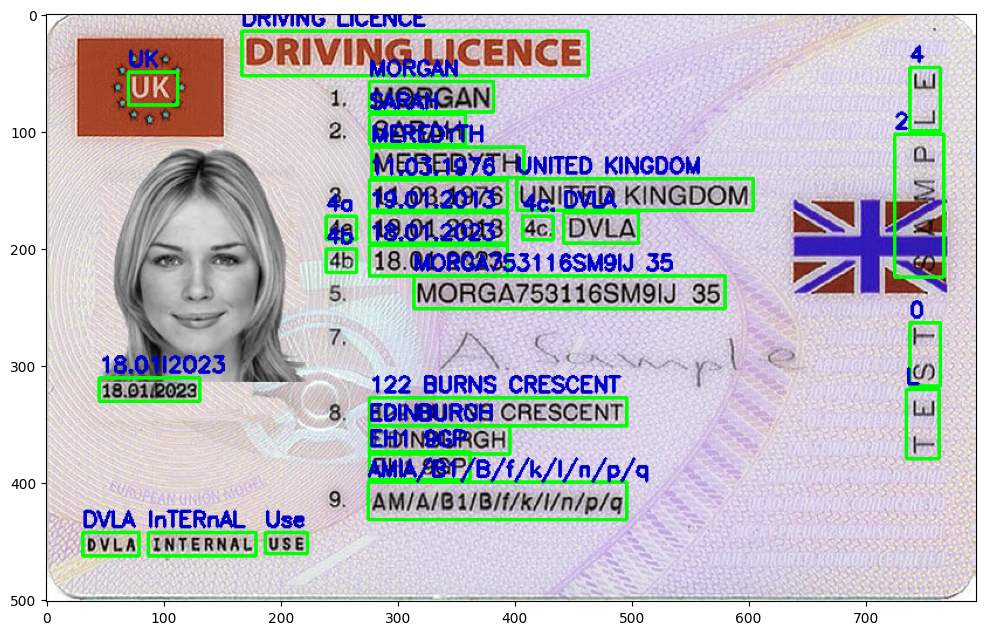

In [26]:
img = cv2.imread(imagem_caminho)

for (rec, txt, prob) in texto:
    # Coordenadas do retângulo a ser desenhado
    (sup_esq, sup_dir, inf_dir, inf_esq) = rec
    sup_esq   = (int(sup_esq[0]), int(sup_esq[1]))
    inf_dir   = (int(inf_dir[0]), int(inf_dir[1]))

    # Identifica, com um retângulo, as regiões da imagem em que houve leitura de texto
    cv2.rectangle(img, sup_esq, inf_dir, (0, 255, 0), 2)

    # Replica, na imagem, os textos identifados
    cv2.putText(img, txt, (sup_esq[0], sup_esq[1] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 200), 2)

plt.rcParams["figure.figsize"] = (12,12)
plt.imshow(img);

Alternativa com fundo preto:

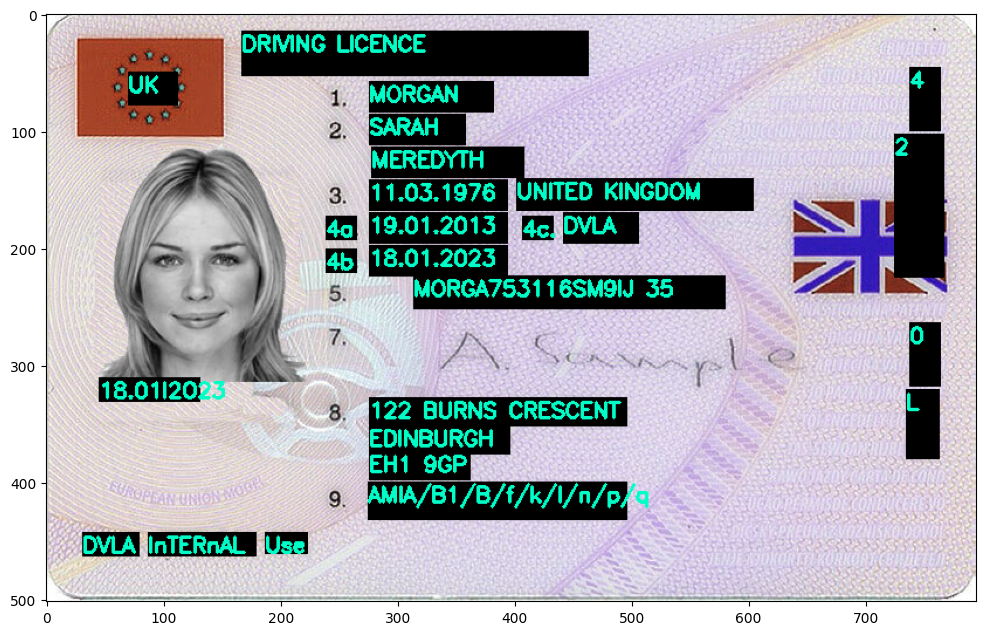

In [27]:
img = cv2.imread(imagem_caminho)

for (rec, txt, prob) in texto:
    # Coordenadas do retângulo a ser desenhado
    (sup_esq, sup_dir, inf_dir, inf_esq) = rec
    sup_esq   = (int(sup_esq[0]), int(sup_esq[1]))
    inf_dir   = (int(inf_dir[0]), int(inf_dir[1]))

    # Identifica, com um retângulo, as regiões da imagem em que houve leitura de texto
    cv2.rectangle(img, sup_esq, inf_dir, (0, 0, 0), -1)

    # Replica, na imagem, os textos identifados
    cv2.putText(img, txt, (sup_esq[0], sup_esq[1] + 17), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 200), 2)

plt.rcParams["figure.figsize"] = (12,12)
plt.imshow(img);

## Lendo um PDF

Para realizar a leitura dos dados, primeiro iremos realizar a sua conversão de PDF para imagem.

In [32]:
paginas = convert_from_path("RP_4600023295_NF_1266.pdf", 500)
paginas

[<PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=4132x5848>,
 <PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=4132x5848>]

Então, podemos salvar cada página como imagem JPG:

In [29]:
i = 1
for pg in paginas:
    pg.save("RP_4600023295_NF_1266_{}.jpg".format(i), "JPEG")
    i += 1

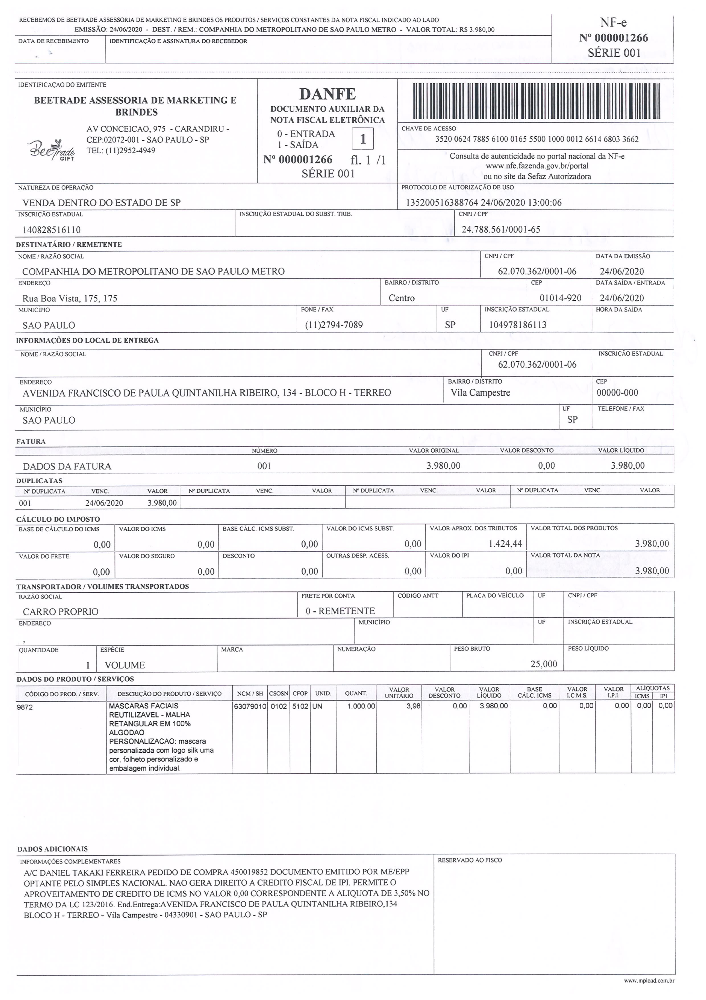

In [33]:
paginas[0]

Agora, podemos utilizar a biblioteca **EasyOCR** para efetuar a tradução de **imagem** para **texto**.

Observe que já importamos a biblioteca. Agora, iremos utilizar o **Reader** do **EasyOCR** para efetuar o processamento.

In [36]:
texto = reader.readtext("RP_4600023295_NF_1266_1.jpg", detail=0)


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:775: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  super().__init__(loader)


Pronto! Com o Reader criado, basta utilizar a função **readtext** passando como parâmetro o caminho até a imagem!

In [ ]:
# Lendo o arquivo RP_4600023295_NF_1266_1.jpg



In [ ]:
# Plotando a imagem RP_4600023295_NF_1266_1.jpg



## Experimento com livros

Iremos recuperar informações de escrita provenientes de livros.

Vamos realizar a leitura de apenas uma página de um livro. Considere que o formato já é JPG.

Primeiro, exibimos a imagem:

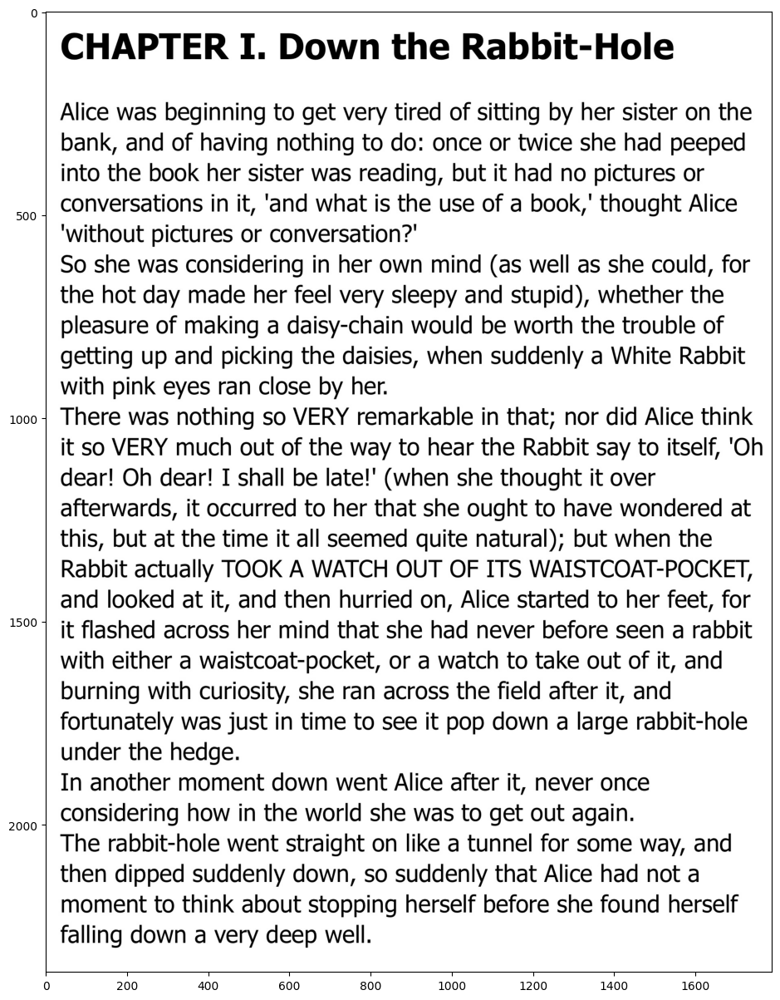

In [37]:
img = cv2.imread("livros_aiwplain1.jpg")

plt.rcParams["figure.figsize"] = (15,15)

plt.imshow(img);

E então podemos fazer o OCR:

In [ ]:
# Lendo a página do livro livros_aiwplain1.jpg



Observe que a saída do *readtext* é uma lista, contendo diversos pequenos pedaços (substrings) do texto completo da página. Para transformar esta lista em uma string completa, podemos fazer:

Agora poderíamos, por exemplo, procurar um termo no texto:

Outras alternativas, vistas nas aulas 01 e 02:
- Remover pontuações e *stopwords*
- Separar em palavras
- Contar frequência de palavras
- Etc.

### Ler vários livros e produzir DataFrame

Considere a lista de páginas de livros:

In [ ]:
lista_livros = ["livros_aiwplain1.jpg",
                "livros_ipad.jpg",
                "livros_nlp.jpg",
                "livros_nlp_2.jpg",
                "livros_nlp_ods_course.jpg"]

**Exercício 1** Crie uma função que recebe um caminho de uma imagem e a exibe na tela. Exiba a imagem de cada um dos livros.

**Exercício 2** Crie um bloco de código que percorre a lista de livros e utiliza o EasyOCR para efetuar a leitura deles (a partir dos arquivos de imagem).

Guarde os textos lidos em um dicionário ou lista, conforme considerar mais fácil e adequado.

**Exercício 3** E se quiséssemos descobrir se um trecho de livro contém determinado termo? Crie um bloco de código que permite procurar um termo em determinado livro.

**Exercício 4** Agora vamos resumir as nossas descobertas dos blocos anteriores. Considere uma lista de termos para o qual desejamos realizar buscas. Exemplo:

In [ ]:
palavras = ["mind", "presentation", "language", "summer", "natural", "rabbit"]

Crie um bloco de código que, a partir dos textos lidos e palavras (termos de busca), produz um DataFrame pandas onde cada linha representa um livro e as colunas representam os termos de busca. Preencha se o termo foi ou não encontrado no livro.

### Exercícios adicionais - Livros

**Exercício 5** Faça uma análise visual da qualidade da identificação dos textos contidos nas imagens.

R:

**Exercício 6** Extraia as probabilidades para cada termo em cada livro (disponibilizada pelo EasyOCR).

a) Identifique estatísticas para cada livro. Probabilidade média, mediana, máxima e mínima.

b) Para cada livro, exiba a distribuição de probabilidades.

## Experimento com notas fiscais

Um exemplo prático do uso de OCR poderia envolver a tradução de dados de imagem de notas fiscais para acompanhamento da prestação de contas por instituições públicas.

Neste exemplo, vários PDFs que contém representações de notas fiscais eletrônicas foram extraídos do site de prestação de contas do Metrô de São Paulo. Os arquivos são aqueles nomeados no padrão **RP_*.pdf**

Links:
- https://transparencia.metrosp.com.br/dataset/contrato-rp-4600023295beetrade-assessoria-de-marketing
- https://transparencia.metrosp.com.br/dataset/contrato-rp4600023527-bt


**Exercício 7** Crie uma função que recebe uma lista de arquivos PDF. Ela deve transformar todos eles para imagem, salvando na mesma pasta, com extensão .jpg.

**Exercício 8** Crie um bloco de código que recebe uma lista de imagens, faz o OCR delas e salva um arquivo de mesmo nome, na mesma pasta, com extensão **.txt**. O arquivo de texto deve conter os caracteres reconhecidos na imagem pelo EasyOCR.

# Caligrafia

Como um experimento, vamos verificar se o EasyOCR consegue identificar caracteres escritos a mão? Para isso, utilizaremos um Canvas com área livre para grafia, com base no pacote **ipycanvas**, disponível em https://ipycanvas.readthedocs.io/en/latest/ ou https://github.com/martinRenou/ipycanvas

Primeiro, vamos importar as bibliotecas necessárias. Já fizemos isso no início do notebook, entretanto, deixaremos aqui para fins didáticos, para que percebam bem quais bibliotecas são necessárias em qual parte da aula.

In [39]:
# Canvas hand drawing
from ipywidgets import Image
from ipywidgets import ColorPicker, IntSlider, link, AppLayout, HBox
from ipycanvas import Canvas, hold_canvas

# OCR
import easyocr

In [ ]:
# !pip install ipycanvas

Caso algum pacote não tenha sido importado corretamente, utilize o pip para instalar.
Por exemplo, para instalar o *ipycanvas*:

**!pip install ipycanvas**

Agora, vamos configurar alguns parâmetros da área de desenho: altura, largura, cor inicial da caneta de desenho e cor de fundo.

Caso queira entender melhor como estamos definindo as cores (padrão RGB em formato hexadecimal), consulte https://www.w3schools.com/Colors/default.asp e https://htmlcolorcodes.com

In [40]:
width = 700
height = 350

stroke_color = "#0068b3"
background_color = "#eeeeee"

e agora, criar a área para desenho. Clique e utilize o mouse para desenhar:

In [41]:
from google.colab import output
output.enable_custom_widget_manager()

In [42]:
canvas = Canvas(width=width, height=height)

drawing = False
position = None
shape = []


def on_mouse_down(x, y):
    global drawing
    global position
    global shape

    drawing = True
    position = (x, y)
    shape = [position]


def on_mouse_move(x, y):
    global drawing
    global position
    global shape

    if not drawing:
        return

    with hold_canvas(canvas):
        canvas.stroke_line(position[0], position[1], x, y)
        position = (x, y)

    shape.append(position)


def on_mouse_up(x, y):
    global drawing
    global position
    global shape

    drawing = False

    with hold_canvas(canvas):
        canvas.stroke_line(position[0], position[1], x, y)
        #canvas.fill_polygon(shape)

    shape = []


canvas.on_mouse_down(on_mouse_down)
canvas.on_mouse_move(on_mouse_move)
canvas.on_mouse_up(on_mouse_up)

canvas.stroke_style = stroke_color

canvas.sync_image_data = True

canvas.fill_style = background_color
canvas.fill_rect(0, 0, canvas.width, canvas.height)

picker = ColorPicker(description="Color:", value=stroke_color)

link((picker, "value"), (canvas, "stroke_style"))
link((picker, "value"), (canvas, "fill_style"))

HBox((canvas, picker))

Vamos criar um **Reader**:

In [43]:
reader = easyocr.Reader(["pt", "en"], gpu = False)

Agora, execute a célula abaixo caso queira utilizar o EasyOCR para realizar o OCR da imagem desenhada a mão:

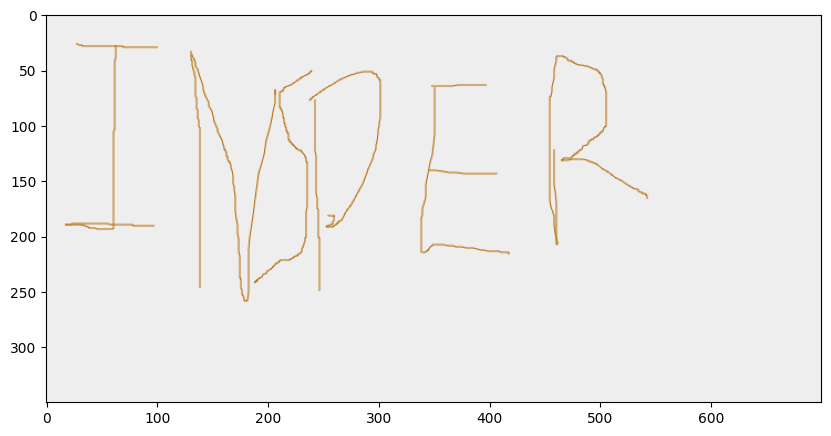

In [44]:
img_name = "img1.png"

canvas.to_file(img_name)

img = cv2.imread(img_name)

plt.rcParams["figure.figsize"] = (10,10)

plt.imshow(img);

In [45]:
reader.readtext(img_name, detail = 0)

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:775: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  super().__init__(loader)


['JEk']

**Exercício 9** Utilize o canvas e responda os exercícios:

a) Desenhe palavras existentes em português. De forma geral, o EasyOCR conseguiu reconhecer corretamente?

R:

b) E quando desenhamos palavras inexistentes (mistura aleatória de caracteres)? Justifique.

R:

c) Tente replicar, desenhando a mão, as seguintes escritas:

<img src="https://atd-insper.s3.us-east-2.amazonaws.com/aula03/handwriting.png">


e compare o desempenho do EasyOCR na identificação dos caracteres das duas imagens. Consegue identificar hipóteses para as diferenças?

Obs: o nome da imagem é *handwriting.png*

R:

# Referências

Todas as imagens e PDFs utilizados nesta aula foram obtidos em buscadores e encontrados de forma pública na Web.

Lista de URLs:

Exercício de Livros:
- https://scrappystickyinkymess.files.wordpress.com/2013/08/aiwplain1.jpg
- http://nlp.ods.asia/Courses/200102.NLP/SLP/slp-preface.pdf
- https://static.docsity.com/documents_pages/notas/2015/02/23/9db87522509edf1a679f14c58f421f51.png
- https://images-na.ssl-images-amazon.com/images/I/71vlGjCEVyL.jpg
- https://help.apple.com/assets/5FF781C3D9C608399A729C42/5FF781C4D9C608399A729C5E/pt_BR/94f62b05596502341b2dd6b73b90fadf.png

Notas Fiscais do Metrô SP:
- https://transparencia.metrosp.com.br/dataset/contrato-rp-4600023295beetrade-assessoria-de-marketing
- https://transparencia.metrosp.com.br/dataset/contrato-rp4600023527-bt

ID Cards:
- https://s.toptests.co.uk/wp-content/uploads/2017/12/uk-driving-licence.jpg
- https://s.driving-tests.org/img/license/alabama-drivers-license.jpg

## Extra: `pytesseract`

Vamos utilizar uma biblioteca diferente, a `pytesseract` para fazer o reconhecimento de caracteres.

Faremos a instalação da aplicação no sistema:

In [46]:
!sudo apt update
!sudo apt install -y tesseract-ocr
!sudo apt install -y libtesseract-dev

Get:1 https://cli.github.com/packages stable InRelease [3,917 B]
Hit:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:3 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:4 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Get:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:9 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,613 kB]
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Fetched 2,001 kB in 2s (1,232 kB/s)
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
82 packages can be upgraded. Run 'apt list --upgradable' to see them.
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https

A instalação da biblioteca python:

In [47]:
!pip install pytesseract

O import da biblioteca python:

In [48]:
import pytesseract

### Exemplo de uso

Vamos abrir a iamgem utilizendo o OpenCV

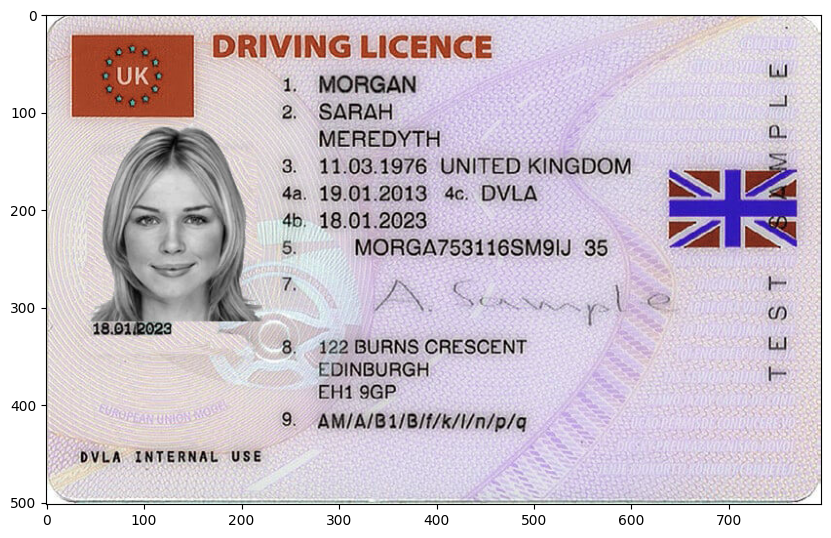

In [49]:
imagem_caminho = "id_uk-driving-licence.jpg"

img = cv2.imread(imagem_caminho)

plt.rcParams["figure.figsize"] = (10,10)

plt.imshow(img);

E utilizar `pytesseract.image_to_string` para fazer a extração

In [51]:
txt = pytesseract.image_to_string(img)
print(txt)

| oun. | DRIVING LICENCE
UN
2, SARAH

DVLA INTERNAL USE

 

1,

3.

. 19.01.2013 4c. DVLA
. 18.01.2023

MORGAN

MEREDYTH
11.03.1976 UNITED KINGDOM

MORGA753116SM9lJ 35

Ps rl é

122 BURNS CRESCENT
EDINBURGH
EH1 9GP.

AM/A/B1/B/f/kK/I/n/p/q

aN /
test Uae ce



Caso queira exibir os bounding boxes, vamos extrair um dicionário com as informações contidas na imagem (texto e mais alguns extras)

In [53]:
img_c = img.copy()
data = pytesseract.image_to_data(img, output_type=pytesseract.Output.DICT)


In [ ]:
data

Então, vamos exibir os bounding boxes

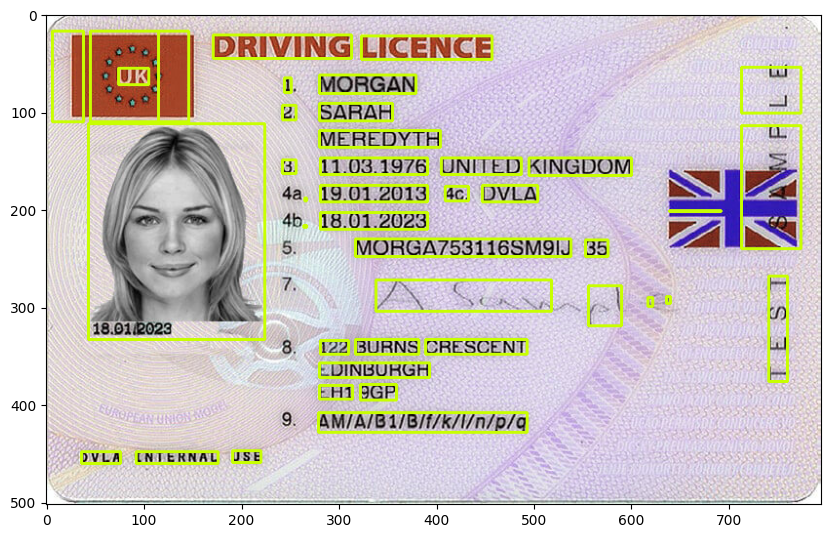

In [54]:
for i in range(len(data["level"])):
    if (data["text"][i] != ""):
        # Extração das coordenadas
        (x, y, width, heigth) = (data["left"][i],
                                 data["top"][i],
                                 data["width"][i],
                                 data["height"][i])
        # Plot do retângulo nas coordenadas
        cv2.rectangle(img_c,
                      (x, y),
                      (x + width, y + heigth),
                      (200, 255, 0),
                      2)

# Exibe imagem resultante
plt.imshow(img_c);

Por hoje é só!